In [ ]:
"""
    Depth estimation example
    More models on https://huggingface.co/models?pipeline_tag=depth-estimation&sort=downloads
    Use SHIFT + ENTER to execute block of code!!!
"""

In [1]:
import numpy as np
import requests
import torch

from PIL import Image
from transformers import DPTForDepthEstimation, DPTFeatureExtractor

/opt/homebrew/Caskroom/miniconda/base/envs/myenv2/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [12]:
model = "Intel/dpt-hybrid-midas"
feature_extractor = DPTFeatureExtractor.from_pretrained("Intel/dpt-hybrid-midas")
model = DPTForDepthEstimation.from_pretrained("Intel/dpt-hybrid-midas", low_cpu_mem_usage=True)

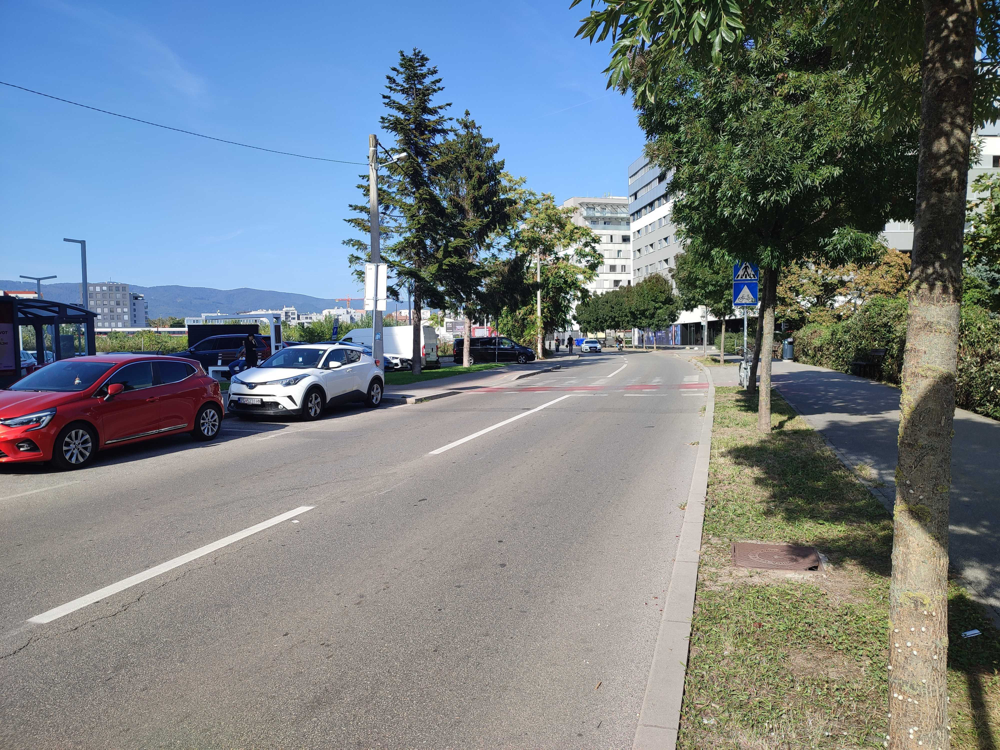

In [3]:
image = Image.open("./images/ZG.jpeg")
image

In [8]:
# prepare image for the model
inputs = feature_extractor(images=image, return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)
    predicted_depth = outputs.predicted_depth

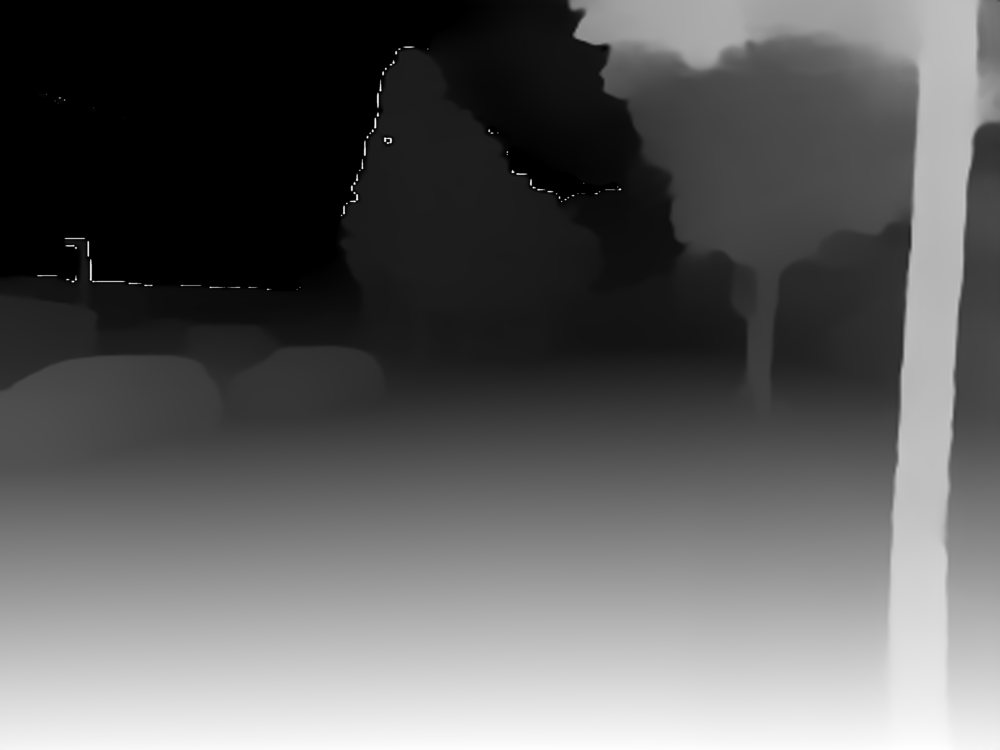

In [10]:
prediction = torch.nn.functional.interpolate(
    predicted_depth.unsqueeze(1),
    size=image.size[::-1],
    mode="bicubic",
    align_corners=False,
)

# visualize the prediction
output = prediction.squeeze().cpu().numpy()
formatted = (output * 255 / np.max(output)).astype("uint8")
depth = Image.fromarray(formatted)
depth